In [1]:
from keras.applications.inception_v3 import InceptionV3
# for mathematical operations
import numpy as np
import pandas as pd
import matplotlib
# for visualizations
import matplotlib.pyplot as plt
import seaborn as sns
# to transform a png to an array
from matplotlib.image import imread
import os
import tensorflow as tf

2024-04-06 20:52:36.031473: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-06 20:52:36.031534: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-06 20:52:36.033011: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
# To generate GIFs
!pip install imageio
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-h4wjqyzn
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-h4wjqyzn
  Resolved https://github.com/tensorflow/docs to commit ec3a1b3f9a604c6cd26c7537f2b9fd270a3eedbf
  Preparing metadata (setup.py) ... done


In [3]:
os.listdir('../input/candlestickimages')
# from google.colab import drive
# drive.mount('/content/drive')

['content']

# GAN

## Setup

In [4]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time
from tensorflow.keras.preprocessing.image import img_to_array, load_img
from IPython import display
from keras.applications.inception_v3 import InceptionV3
# for mathematical operations
import numpy as np
import pandas as pd
import matplotlib
# for visualizations
import matplotlib.pyplot as plt
import seaborn as sns
# to transform a png to an array
from matplotlib.image import imread
import os
import tensorflow as tf
from IPython import display

from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Flatten, Reshape
from tensorflow.keras.layers import BatchNormalization, Dropout
from tensorflow.keras.layers import ReLU, LeakyReLU, Activation
from tensorflow.keras.optimizers import Adam

In [5]:
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Flatten, Reshape
from tensorflow.keras.layers import ReLU, LeakyReLU, Activation
from tensorflow.keras.layers import BatchNormalization, Dropout
from tensorflow.keras.optimizers import Adam

try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except Exception as e:
    print("can't initialize tpu, using default, exception: " + str(e))
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE

# empty lists to store image paths
hs_img_path = []
ihs_img_path = []

#  !TODO: FIX ME HERE
# Replace the path in the os.listdir to the file path to our dataset. What should them be and how to set it up for sharing?
for image_path in os.listdir('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/H&S-NonShaded/H&S-NonShaded-Bear-90_'): # loop through all image names in 'H&S' folder
    hs_img_path.append('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/H&S-NonShaded/H&S-NonShaded-Bear-90_/' + image_path) # create the path for the particular image
for image_path in os.listdir('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/H&S-NonShaded/H&S-NonShaded-Bull-10_'): # loop through all image names in 'H&S' folder
    hs_img_path.append('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/H&S-NonShaded/H&S-NonShaded-Bull-10_/' + image_path) # create the path for the particular image

for image_path in os.listdir('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/IH&S-NonShaded/IH&S-NonShaded-Bear-10_'): # loop through all image names in 'IH&S' folder
    ihs_img_path.append('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/IH&S-NonShaded/IH&S-NonShaded-Bear-10_/' + image_path) # create the path for the particular image

for image_path in os.listdir('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/IH&S-NonShaded/IH&S-NonShaded-Bull-90_'): # loop through all image names in 'IH&S' folder
    ihs_img_path.append('../input/candlestickimages/content/drive/MyDrive/CandleStick-image/IH&S-NonShaded/IH&S-NonShaded-Bull-90_/' + image_path) # create the path for the particular image

pattern_type_hs = len(hs_img_path) * ['head_and_shoulder'] # create a list with all values as 'parasitized' with the length of list being the length of par_img_path
pattern_type_ihs = len(ihs_img_path) * ['inverse_head_and_shoulder'] # create a list with all values as 'uninfected' with the length of list being the length of uninf_img_path

# create a dataframe with a column containing hs images' path and another column with the label from pattern
df_hs = pd.DataFrame({'image_path': hs_img_path, 'pattern_type': pattern_type_hs})
# create a dataframe with a column containing ihs images' path and another column with the label from pattern
df_ihs = pd.DataFrame({'image_path': ihs_img_path, 'pattern_type': pattern_type_ihs})



df_hs = df_hs.reset_index(drop=True) # reset index to be from 0 to length of dataframe. drop=True drops the initial index, which otherwise is added as a new column
df_ihs = df_ihs.reset_index(drop=True)

can't initialize tpu, using default, exception: Please provide a TPU Name to connect to.
Number of replicas: 1


In [6]:
df_hs

,image_path,pattern_type
0,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
1,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
2,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
3,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
4,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
5,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
6,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
7,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
8,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder
9,../input/candlestickimages/content/drive/MyDri...,head_and_shoulder


In [7]:
from tensorflow.keras.mixed_precision import set_global_policy
set_global_policy('float32')

In [8]:
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
user_credential = user_secrets.get_gcloud_credential()
user_secrets.set_tensorflow_credential(user_credential)

In [9]:
# from kaggle_datasets import KaggleDatasets
# gcs_path = KaggleDatasets().get_gcs_path()
# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

In [10]:
# def load_and_preprocess_image(path):
#     # Load image and resize it
#     img = load_img(path, target_size=(image_shape[0], image_shape[1]))
#     img = img_to_array(img)
#     # Normalize to [-1, 1]
#     img = (img - 127.5) / 127.5
#     return img

# # Apply the function to each image path
# image_paths = df['image_path'].values
# images = np.array([load_and_preprocess_image(path) for path in image_paths])

# image_shape = (256, 256, 3)
# import tensorflow as tf

# def load_and_preprocess_image(path):
#     # Convert path to tensor
#     img = tf.io.read_file(path)
#     img = tf.image.decode_image(img, channels=3, expand_animations=False)
#     img = tf.image.resize(img, (image_shape[0], image_shape[1]))
#     # Normalize to [-1, 1]
#     img = (img - 255.5) / 255.5
#     return img

# image_paths = df['image_path'].values
# path_ds = tf.data.Dataset.from_tensor_slices(image_paths)
# image_dataset = path_ds.map(load_and_preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
# return the image from the TFRecord
image_size = [256, 256]

def decode_image(image):
    image = tf.image.decode_jpeg(image, channels=3)
    image = (tf.cast(image, tf.float32) / 127.5) - 1
    image = tf.reshape(image, [*image_size, 3])
    return image
def load_and_preprocess_image(image_path, label):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [256, 256])
    image = (tf.cast(image, tf.float32) / 127.5) - 1
    return image, label
# Assuming `df` is your DataFrame with `image_path` and `pattern_type` columns
# labels = df['pattern_type'].map({'head_and_shoulder': 0, 'inverse_head_and_shoulder': 1}).values
# paths = df['image_path'].values
labels_hs = df_hs['pattern_type'].map({'head_and_shoulder': 0, 'inverse_head_and_shoulder': 1}).values
paths_hs = df_hs['image_path'].values
labels_ihs = df_ihs['pattern_type'].map({'head_and_shoulder': 0, 'inverse_head_and_shoulder': 1}).values
paths_ihs = df_ihs['image_path'].values
# Convert to TensorFlow Dataset
# dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
dataset_hs = tf.data.Dataset.from_tensor_slices((paths_hs, labels_hs))
dataset_ihs = tf.data.Dataset.from_tensor_slices((paths_ihs, labels_ihs))
# Map the loading and preprocessing function
AUTOTUNE = tf.data.AUTOTUNE
# dataset = dataset.map(lambda x, y: load_and_preprocess_image(x, y), num_parallel_calls=AUTOTUNE)
dataset_hs = dataset_hs.map(lambda x, y: load_and_preprocess_image(x, y), num_parallel_calls=AUTOTUNE)
dataset_ihs = dataset_ihs.map(lambda x, y: load_and_preprocess_image(x, y), num_parallel_calls=AUTOTUNE)
# Shuffle and batch the dataset
BATCH_SIZE = 32
BUFFER_SIZE = 1000
# candlestick_ds = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).prefetch(AUTOTUNE)
# train_dataset = tf.data.Dataset.from_tensor_slices(images)
candlestick_ds_hs = dataset_hs.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
candlestick_ds_ihs = dataset_ihs.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [11]:
# hs_image_paths = df['image_path'].values
# hs_images = np.array([load_and_preprocess_image(path) for path in image_paths])
# ihs_image_paths = df['image_path'].values
# ihs_images = np.array([load_and_preprocess_image(path) for path in image_paths])

In [12]:
candlestick_ds_ihs

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [13]:
# BATCH_SIZE = 32  # Start with a smaller batch size
# BUFFER_SIZE = 1000  # Adjust based on your dataset size, smaller if memory issues persist

# train_dataset = image_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# # Create a TensorFlow dataset from the image tensor
# train_dataset = tf.data.Dataset.from_tensor_slices(images)

# # Shuffle and batch the dataset
# BUFFER_SIZE = 60000  # Adjust based on your dataset size
# BATCH_SIZE = 256     # Adjust based on your training setup and GPU capacity

# train_dataset = train_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
# shape_dim = [256,256,3]

## The Generator

In [14]:
# def make_generator_model():
#     model = tf.keras.Sequential()
#     model.add(layers.Dense(75*125*256, use_bias=False, input_shape=(100,)))
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     # Adjust the reshape dimensions to start with
#     model.add(layers.Reshape((75, 125, 256)))
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     # Example: Add Conv2DTranspose layers to upscale to the target size
#     # This is a simplified example. You'll likely need more layers and adjustments
#     model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     # Final layer to produce a 300x500 RGB image
#     model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))

#     return model
# create a function to build the generator model
def make_generator_model():
    model = Sequential(name="Generator")
    
    # Hidden Layer 1: Start with 16 x 16 image
    n_nodes = 16 * 16 * 512 # number of nodes in the first hidden layer
    model.add(Dense(n_nodes, input_shape=(100,), name='Generator-Hidden-Layer-1'))
    model.add(Reshape((16, 16, 512), name='Generator-Hidden-Layer-Reshape-1'))
   
    # Hidden Layer 2: Upsample to 32 x 32
    model.add(Conv2DTranspose(filters=256, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-2'))
    model.add(LeakyReLU(alpha=0.2))
        
    # Hidden Layer 3: Upsample to 64 x 64
    model.add(Conv2DTranspose(filters=128, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-3'))
    model.add(LeakyReLU(alpha=0.2))
        
    # Hidden Layer 4: Upsample to 128 x 128
    model.add(Conv2DTranspose(filters=64, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-4'))
    model.add(LeakyReLU(alpha=0.2))
        
    # Hidden Layer 5: Upsample to 256 x 256
    model.add(Conv2DTranspose(filters=32, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-5'))
    model.add(LeakyReLU(alpha=0.2))
        
    # Output Layer: we use 3 filters because we have 3 channels for a color image.
    model.add(Conv2DTranspose(3, kernel_size=(3, 3), activation='tanh', strides=(1, 1), padding='same', name='Generator-Output-Layer'))
  
    return model

generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [15]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

/opt/conda/lib/python3.10/site-packages/keras/src/layers/core/dense.py:85: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/conda/lib/python3.10/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [16]:
# Show model summary
generator.summary()

Model: "Generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ Generator-Hidden-Layer-1        │ (None, 131072)         │    13,238,272 │
│ (Dense)                         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Generator-Hidden-Layer-Reshape… │ (None, 16, 16, 512)    │             0 │
│ (Reshape)                       │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Generator-Hidden-Layer-2        │ (None, 32, 32, 256)    │     1,179,904 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Generator-Hidden-Layer-3        │ (None, 64, 64, 128)    │       295,040 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Generator-Hidden-Layer-4        │ (None, 128, 128, 64)   │        73,792 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Generator-Hidden-Layer-5        │ (None, 256, 256, 32)   │        18,464 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 256, 256, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Generator-Output-Layer          │ (None, 256, 256, 3)    │           867 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,806,339 (56.48 MB)

 Trainable params: 14,806,339 (56.48 MB)

 Non-trainable params: 0 (0.00 B)

## The Discriminator

In [17]:
# def make_discriminator_model():
#     model = tf.keras.Sequential()
#     # Adjust the input_shape to match the new size of generated images
#     model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[300, 500, 3]))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     # Additional convolutional layers might be needed to process the larger input size
#     model.add(layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     model.add(layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     model.add(layers.Flatten())
#     model.add(layers.Dense(1))

#     return model

def make_discriminator_model():
    model = Sequential(name="Discriminator") # Model
    
    # Hidden Layer 1
    model.add(Conv2D(filters=32, kernel_size=(3,3), strides=(2, 2), padding='same', input_shape=[256, 256, 3], name='Discriminator-Hidden-Layer-1'))
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-1'))
    
    # Hidden Layer 2
    model.add(Conv2D(filters=64, kernel_size=(3,3), strides=(2, 2), padding='same', name='Discriminator-Hidden-Layer-2'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-2'))
       
    # Hidden Layer 3
    model.add(Conv2D(filters=128, kernel_size=(3,3), strides=(2, 2), padding='same', name='Discriminator-Hidden-Layer-3'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-3'))
      
    # Hidden Layer 4
    model.add(Conv2D(filters=256, kernel_size=(3,3), strides=(2, 2), padding='same', name='Discriminator-Hidden-Layer-4'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-4'))
  
    # Hidden Layer 5
    model.add(Conv2D(filters=512, kernel_size=(3,3), strides=(2, 2), padding='same', name='Discriminator-Hidden-Layer-5'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-5'))
    
    # Flatten and Output Layers
    model.add(Flatten(name='Discriminator-Flatten-Layer')) # Flatten the shape
    model.add(Dropout(0.3, name='Discriminator-Flatten-Layer-Dropout')) # Randomly drop some connections for better generalization
    model.add(Dense(1, activation='sigmoid', name='Discriminator-Output-Layer')) # Output Layer
    
    return model

In [18]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


tf.Tensor([[0.49997807]], shape=(1, 1), dtype=float32)


In [19]:
discriminator.summary()

Model: "Discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ Discriminator-Hidden-Layer-1    │ (None, 128, 128, 32)   │           896 │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-Act… │ (None, 128, 128, 32)   │             0 │
│ (LeakyReLU)                     │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-2    │ (None, 64, 64, 64)     │        18,496 │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-Act… │ (None, 64, 64, 64)     │             0 │
│ (LeakyReLU)                     │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-3    │ (None, 32, 32, 128)    │        73,856 │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-Act… │ (None, 32, 32, 128)    │             0 │
│ (LeakyReLU)                     │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-4    │ (None, 16, 16, 256)    │       295,168 │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-Act… │ (None, 16, 16, 256)    │             0 │
│ (LeakyReLU)                     │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-5    │ (None, 8, 8, 512)      │     1,180,160 │
│ (Conv2D)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 8, 8, 512)      │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Hidden-Layer-Act… │ (None, 8, 8, 512)      │             0 │
│ (LeakyReLU)                     │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Flatten-Layer     │ (None, 32768)          │             0 │
│ (Flatten)                       │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Flatten-Layer-Dr… │ (None, 32768)          │             0 │
│ (Dropout)                       │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Discriminator-Output-Layer      │ (None, 1)              │        32,76

 Total params: 1,605,185 (6.12 MB)

 Trainable params: 1,603,265 (6.12 MB)

 Non-trainable params: 1,920 (7.50 KB)

## Loss Function

In [20]:
# # This method returns a helper function to compute cross entropy loss
# cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
# def discriminator_loss(real_output, fake_output):
#     real_loss = cross_entropy(tf.ones_like(real_output), real_output)
#     fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
#     total_loss = real_loss + fake_loss
#     return total_loss
# def generator_loss(fake_output):
#     return cross_entropy(tf.ones_like(fake_output), fake_output)

def generator_loss(fake_output):
        cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)
        return cross_entropy(tf.ones_like(fake_output), fake_output)

    # create loss function for the discriminator
def discriminator_loss(real_output, fake_output):
        cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)
        real_loss = cross_entropy(tf.ones_like(real_output), real_output)
        fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
        total_loss = real_loss + fake_loss
        return total_loss

In [21]:
# generator_optimizer = tf.keras.optimizers.Adam(1e-4)
# discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

## Checkpoints

In [30]:
# checkpoint_dir = './output/training_checkpoints'
# checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
# checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
#                                  discriminator_optimizer=discriminator_optimizer,
#                                  generator=generator,
#                                  discriminator=discriminator)
EPOCHS = 1500
BATCH_SIZE = 32
noise_dim = 100
shape_dim = [256,256,3]

In [31]:
class DCGAN_model:
    def __init__(self, noise_dim, EPOCHS, BATCH_SIZE, generator, discriminator, dataset):  
        self.noise_dim = noise_dim
        self.EPOCHS = EPOCHS
        self.BATCH_SIZE = BATCH_SIZE
        self.generator = generator
        #self.discriminator = discriminator2
        self.dataset = dataset
    
    @tf.function
    def train(self, images):
    
    # Create random noise vector
        noise = tf.random.normal([images.shape[0], noise_dim])

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        
        # generate images use random noise vector
            generated_images = self.generator(noise, training=True)

            # use discriminator to evaluate the real and fake images
            real_output = discriminator(images, training=True)
            fake_output = discriminator(generated_images, training=True)

            # compute generator loss and discriminator loss
            gen_loss = generator_loss(fake_output)
            disc_loss = discriminator_loss(real_output, fake_output)

            # Compute gradients
            gradients_of_generator = gen_tape.gradient(gen_loss, self.generator.trainable_variables)
            gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

            # Update optimizers
            generator_optimizer.apply_gradients(zip(gradients_of_generator, self.generator.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
        
        return (gen_loss + disc_loss) * 0.5
    
    @tf.function
    def distributed_train(self, images):
        per_replica_losses = strategy.run(self.train, args=(images,))
        return strategy.reduce(tf.distribute.ReduceOp.MEAN, per_replica_losses, axis=None)
    
    def generate_images(self):
        noise = tf.random.normal([self.BATCH_SIZE, self.noise_dim]) 
        predictions = self.generator.predict(noise)
        return predictions
        
    def generate_and_plot_images(self):      
        image = self.generate_images()
        gen_imgs = 0.5 * image + 0.5
        fig = plt.figure(figsize=(10, 10))
        for i in range(25):
            plt.subplot(5, 5, i+1)
            plt.imshow(gen_imgs[i, :, :, :])
            plt.axis('off')
        plt.show()
#     def generate_and_plot_images(self):
#         images = self.generate_images()  # Generate a batch of images
#         image = images[0]
#         print("Image dtype:", image.dtype)
#         print("Image shape:", image.shape)
#         print("Min pixel value:", image.min())
#         print("Max pixel value:", image.max())
    
    def get_dataset(self):
        return self.dataset

    def train_loop(self):
        e_ls = []
        mean_ls = []
        for epoch in range(self.EPOCHS):
            start = time.time()

            total_loss = 0.0
            num_batches = 0

            for image_batch, _ in self.dataset:
                loss = self.distributed_train(image_batch)
                total_loss += tf.reduce_mean(loss)
                num_batches += 1
            mean_loss = total_loss / num_batches

            if (epoch+1) % 200 == 0:                                  
                print ('Time for epoch {} is {} sec, mean loss is {}'.format(epoch + 1, time.time()-start, mean_loss))
                self.generate_and_plot_images()
                
                e_ls.append(epoch+1)
                mean_ls.append(mean_loss)
        print("\nMean Loss for every 200 epochs: \n")
        table = pd.DataFrame({"Epoch": e_ls, "Mean Loss": np.array(mean_ls)})
        return table

## Train For HS

/opt/conda/lib/python3.10/site-packages/keras/src/backend/tensorflow/nn.py:669: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


Time for epoch 200 is 0.23438596725463867 sec, mean loss is 3.6248137950897217
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


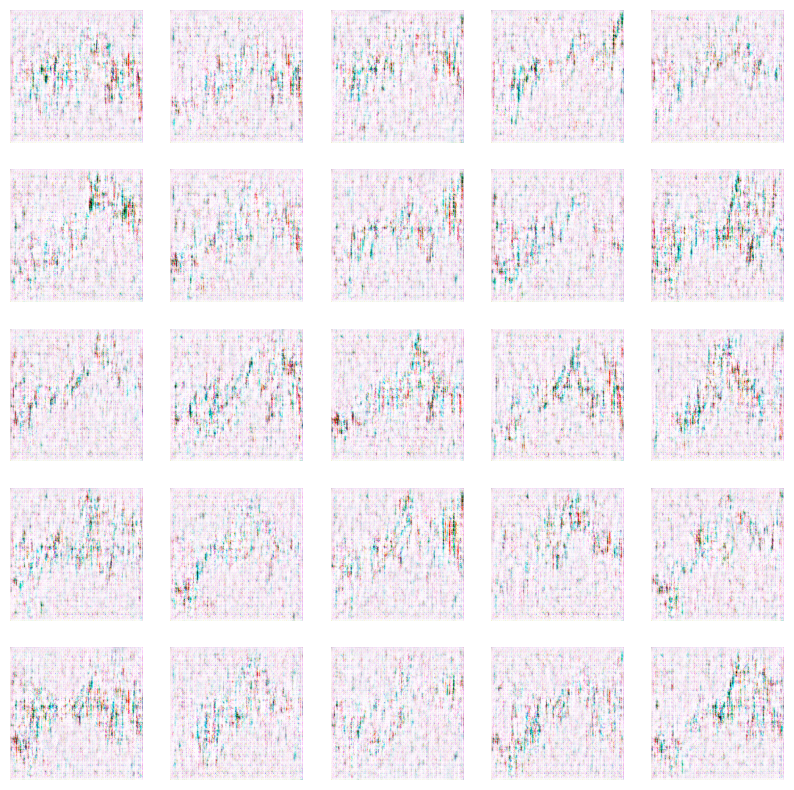

Time for epoch 400 is 0.22909760475158691 sec, mean loss is 2.8923661708831787
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


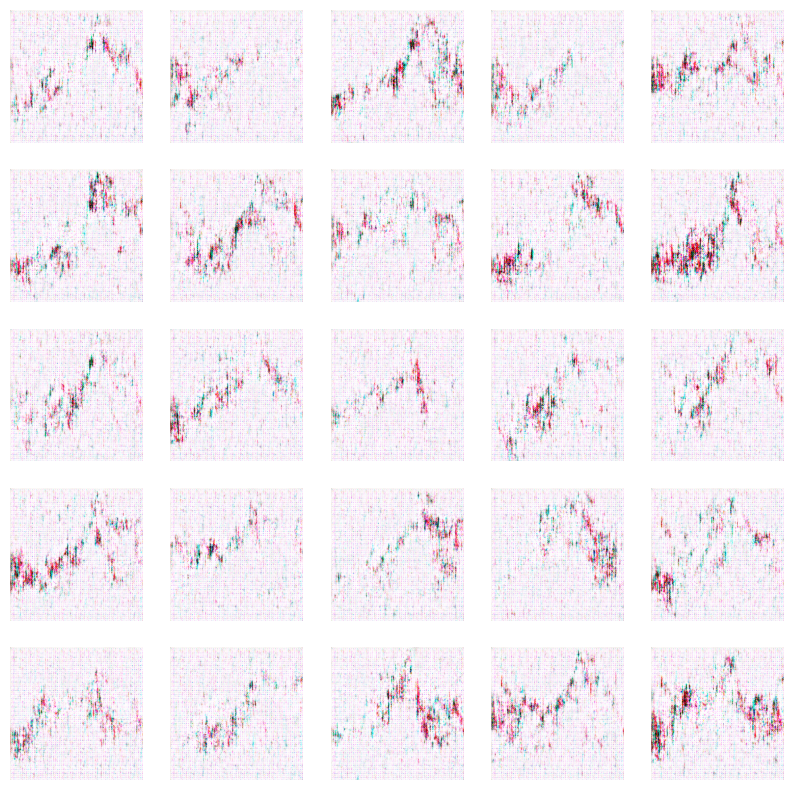

Time for epoch 600 is 0.23089861869812012 sec, mean loss is 3.7748172283172607
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


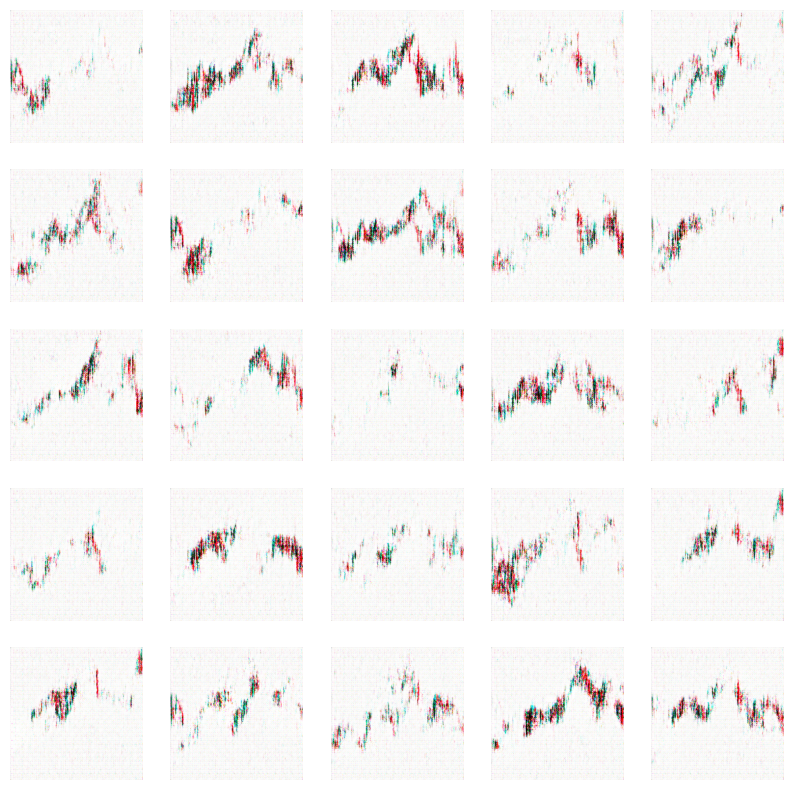

Time for epoch 800 is 0.22884607315063477 sec, mean loss is 2.4854722023010254
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


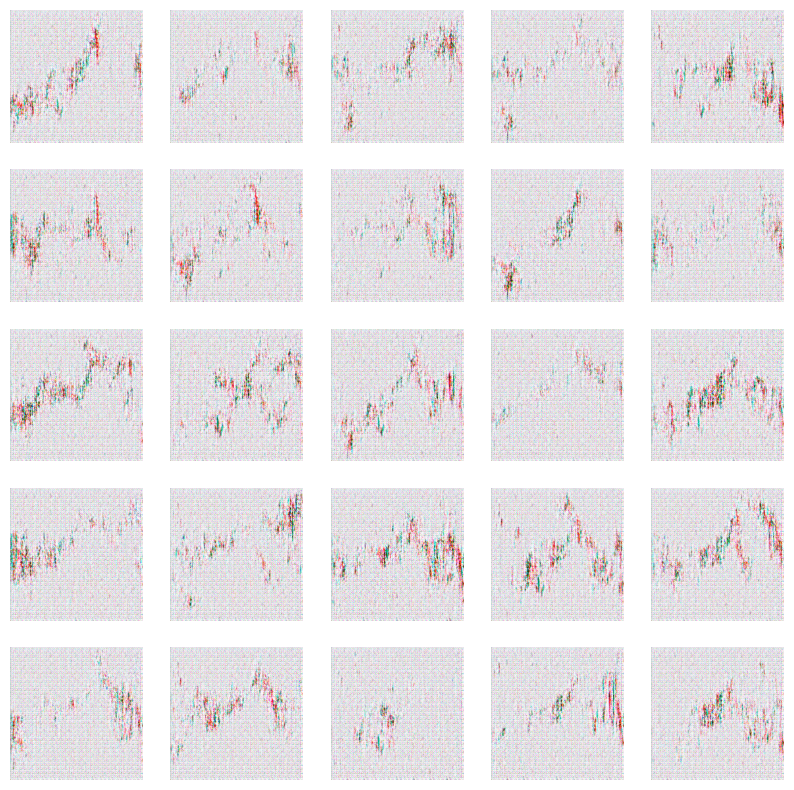

Time for epoch 1000 is 0.22811484336853027 sec, mean loss is 3.4809632301330566
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


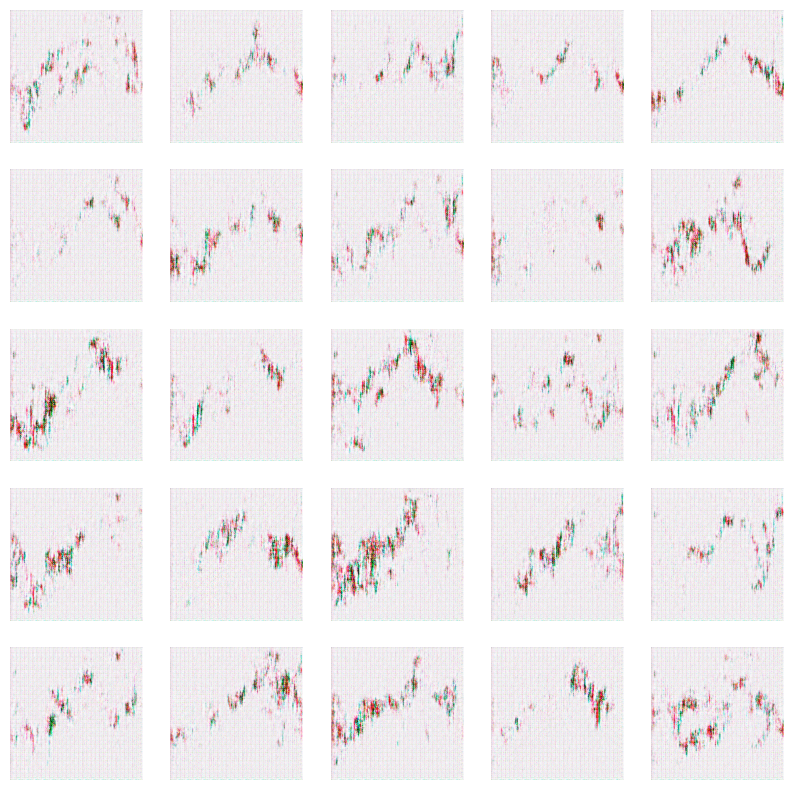

Time for epoch 1200 is 0.23067688941955566 sec, mean loss is 4.928433895111084
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


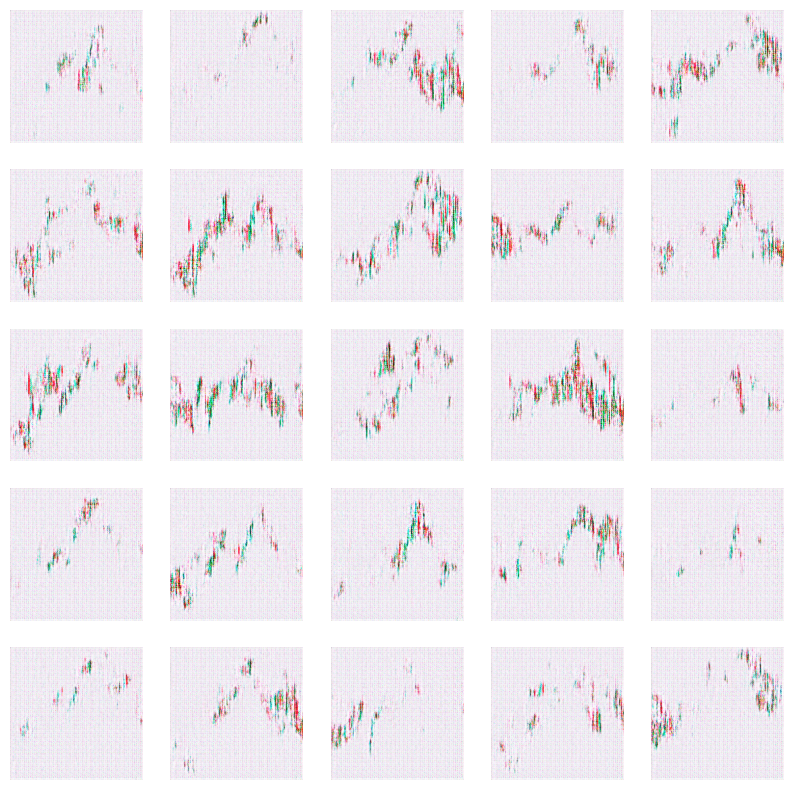

Time for epoch 1400 is 0.23025774955749512 sec, mean loss is 3.1572258472442627
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


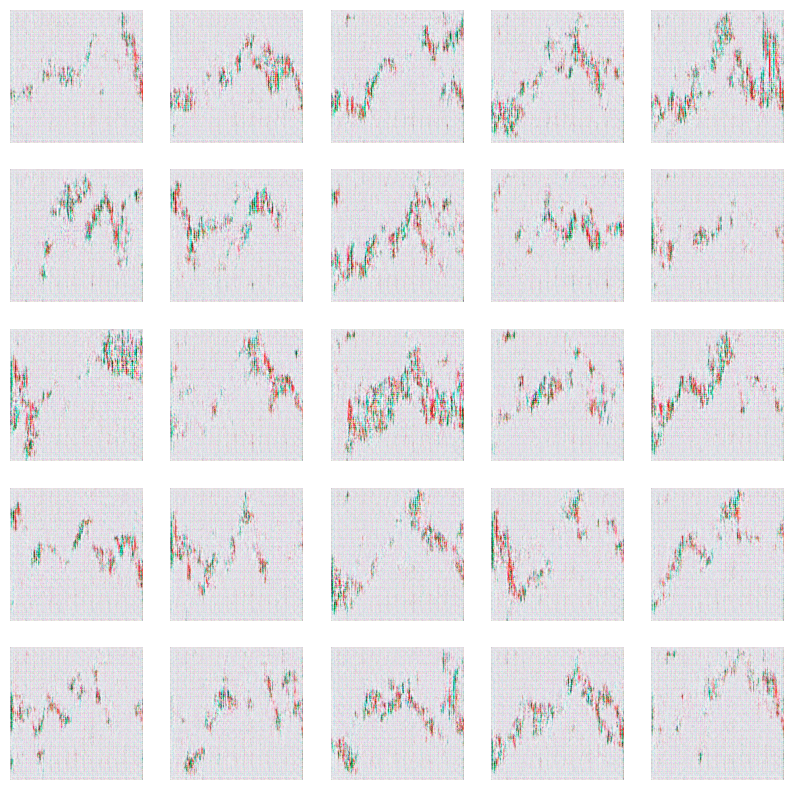


Mean Loss for every 200 epochs: 



,Epoch,Mean Loss
0,200,3.624814
1,400,2.892366
2,600,3.774817
3,800,2.485472
4,1000,3.480963
5,1200,4.928434
6,1400,3.157226


In [32]:
# train(train_dataset, EPOCHS)
gan_hs = DCGAN_model(noise_dim, EPOCHS, BATCH_SIZE, generator, discriminator, candlestick_ds_hs)
# dataset = gan_hs.get_dataset()
res_hs = gan_hs.train_loop()
res_hs
# dataset

mkdir: cannot create directory '../gan_images': File exists
mkdir: cannot create directory '../gan_images/hs': File exists
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1

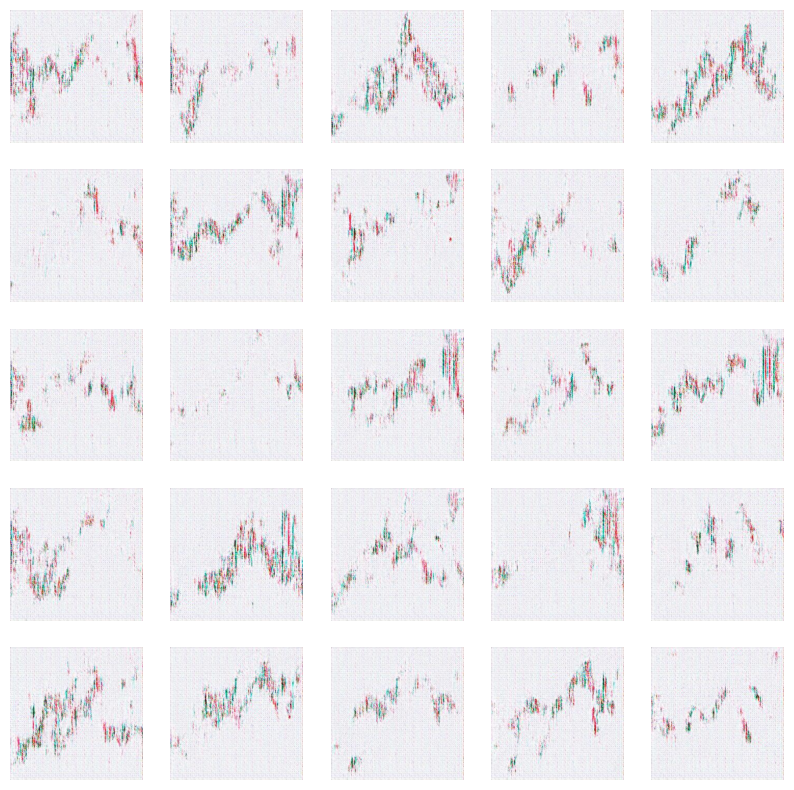

In [34]:
# checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
from PIL import Image
!mkdir ../gan_images
!mkdir ../gan_images/hs
start = time.time()
with strategy.scope():
    for i in range(420):
        noise = tf.random.normal([BATCH_SIZE, noise_dim])
        img = generator.predict(noise)
        img = 0.5 * img + 0.5
        img = (img * 255).astype('uint8')
        img = Image.fromarray(img[0, :, :, :])
        img.save("../gan_images/hs" + str(i) + ".jpg")
print('Total running time is {} sec'.format(time.time()-start))
fig = plt.figure(figsize=(10, 10))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.imshow(PIL.Image.open("../gan_images/hs" + str(i) + ".jpg"))
    plt.axis('off')
plt.show()

/opt/conda/lib/python3.10/site-packages/keras/src/backend/tensorflow/nn.py:669: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


Time for epoch 200 is 0.22063255310058594 sec, mean loss is 3.2543039321899414
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


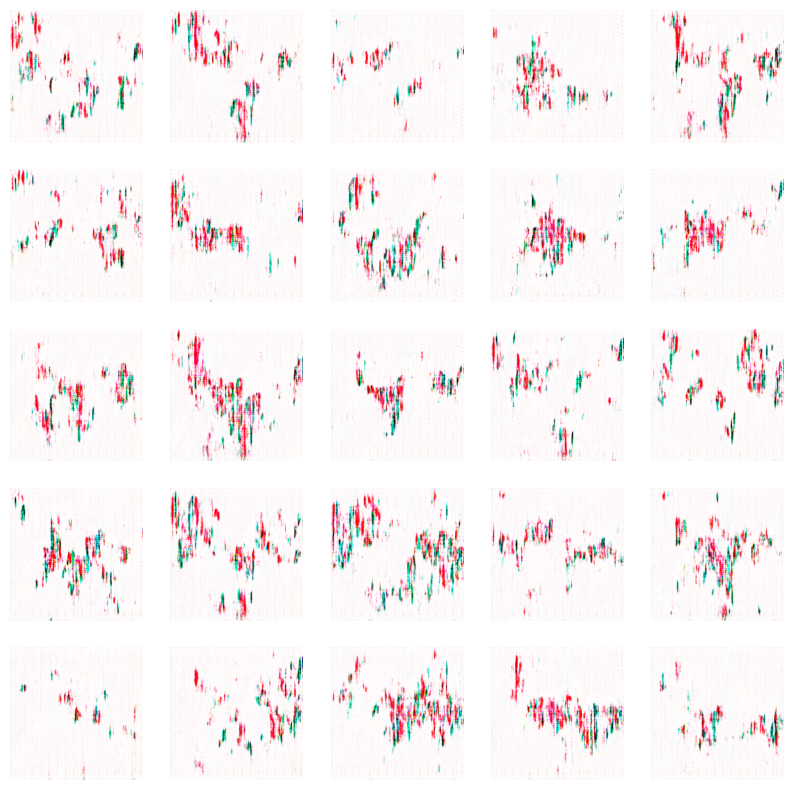

Time for epoch 400 is 0.22124981880187988 sec, mean loss is 3.6862316131591797
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


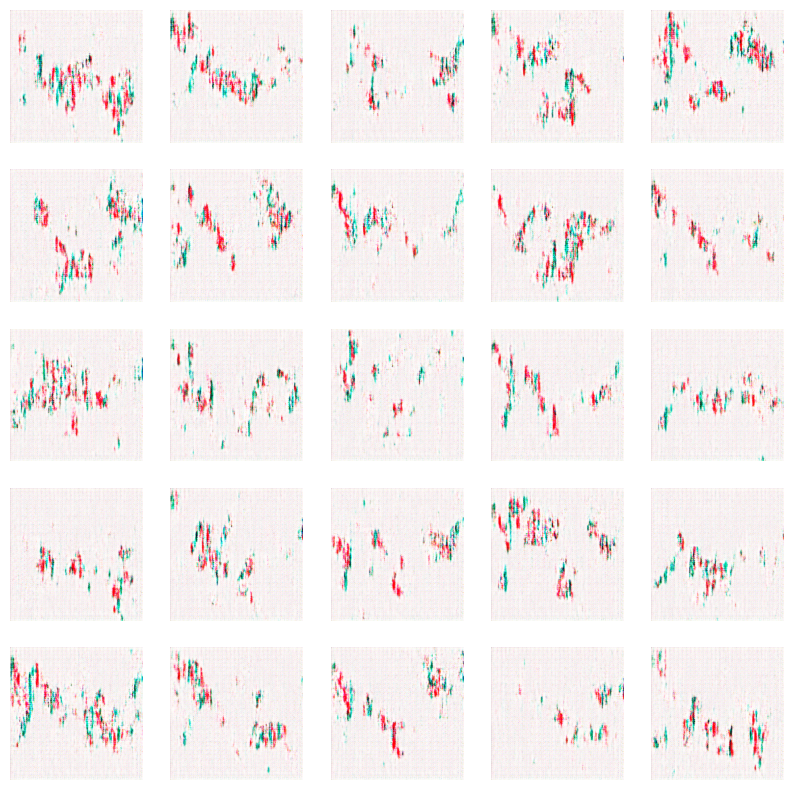

Time for epoch 600 is 0.22073960304260254 sec, mean loss is 2.968532085418701
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


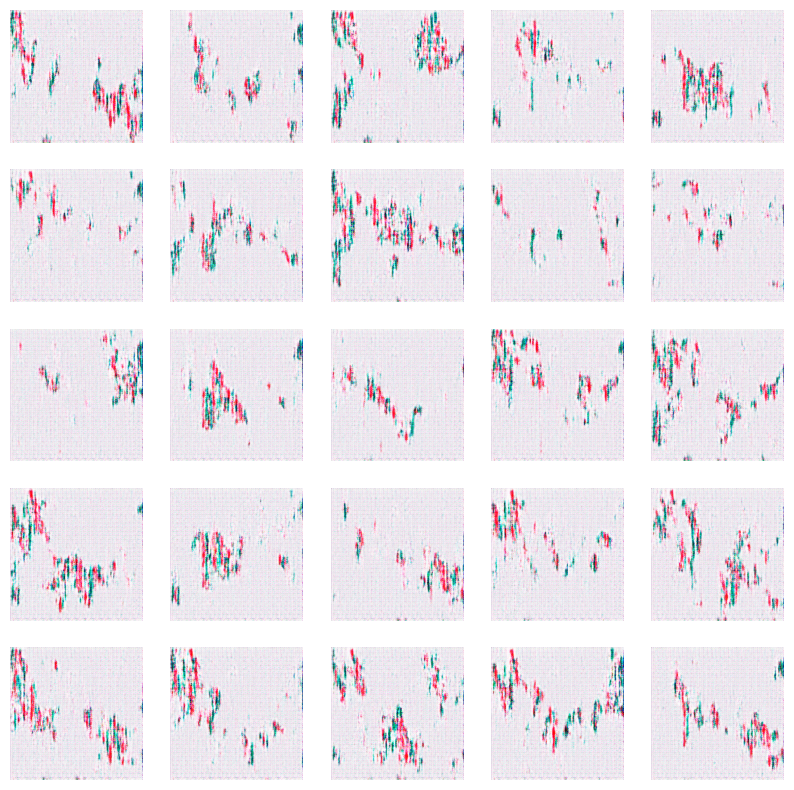

Time for epoch 800 is 0.22019529342651367 sec, mean loss is 3.602250099182129
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


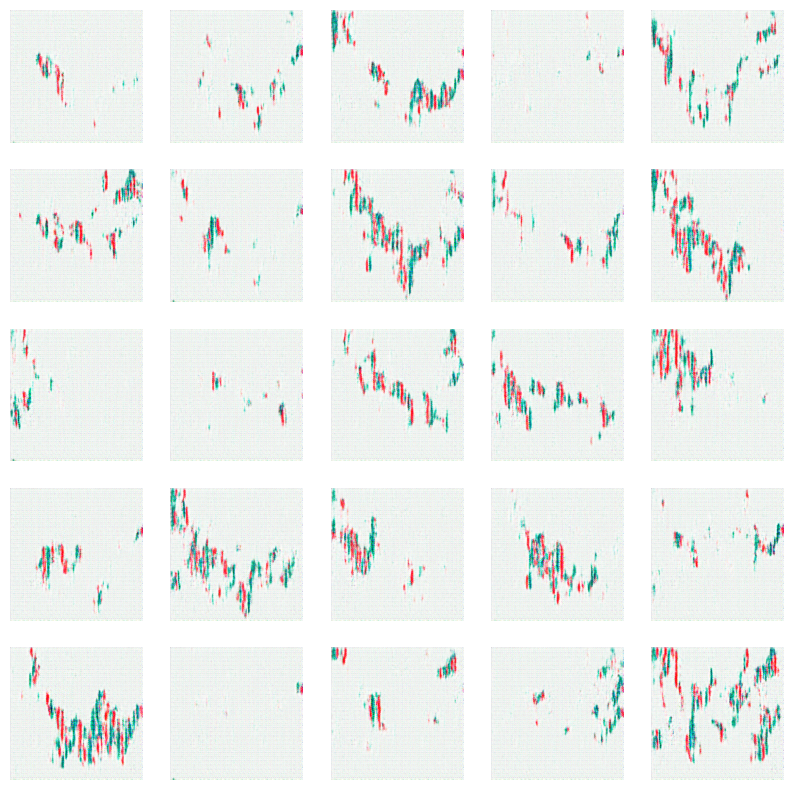

Time for epoch 1000 is 0.22154736518859863 sec, mean loss is 4.832980155944824
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


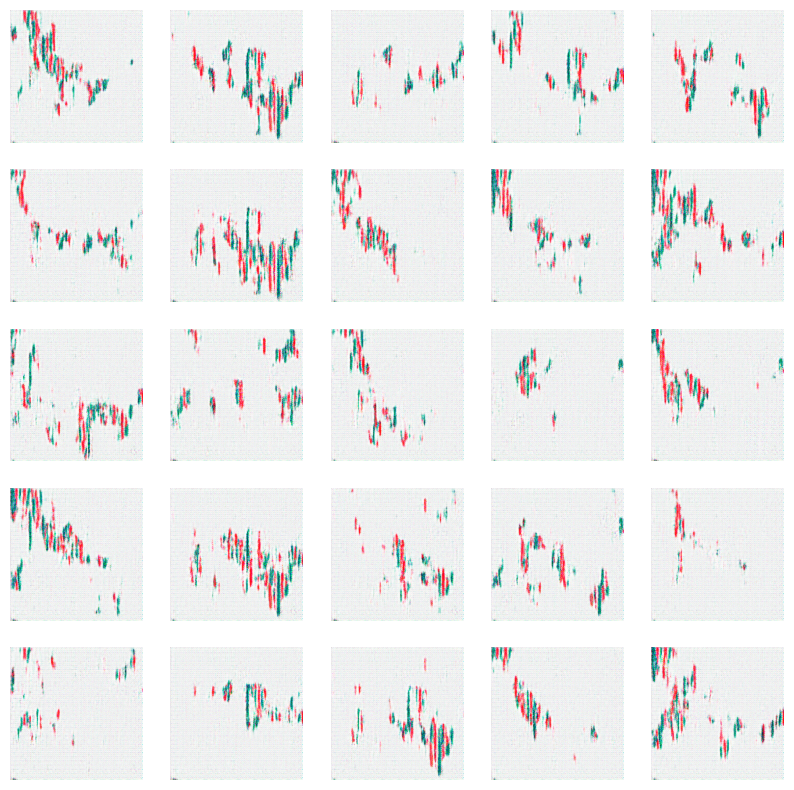

Time for epoch 1200 is 0.21750974655151367 sec, mean loss is 2.9977970123291016
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


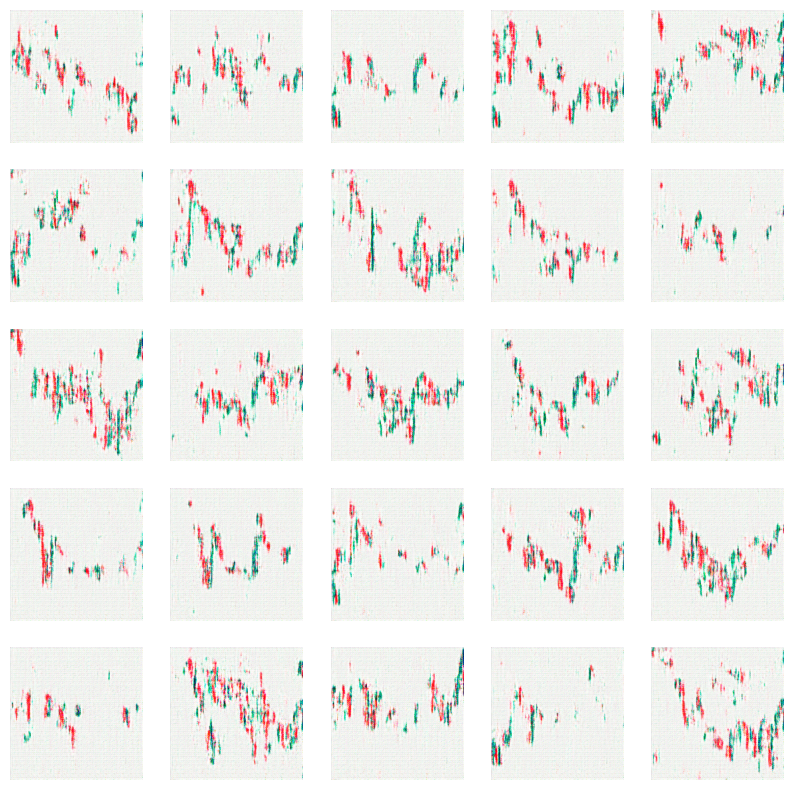

Time for epoch 1400 is 0.21980977058410645 sec, mean loss is 4.047863483428955
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


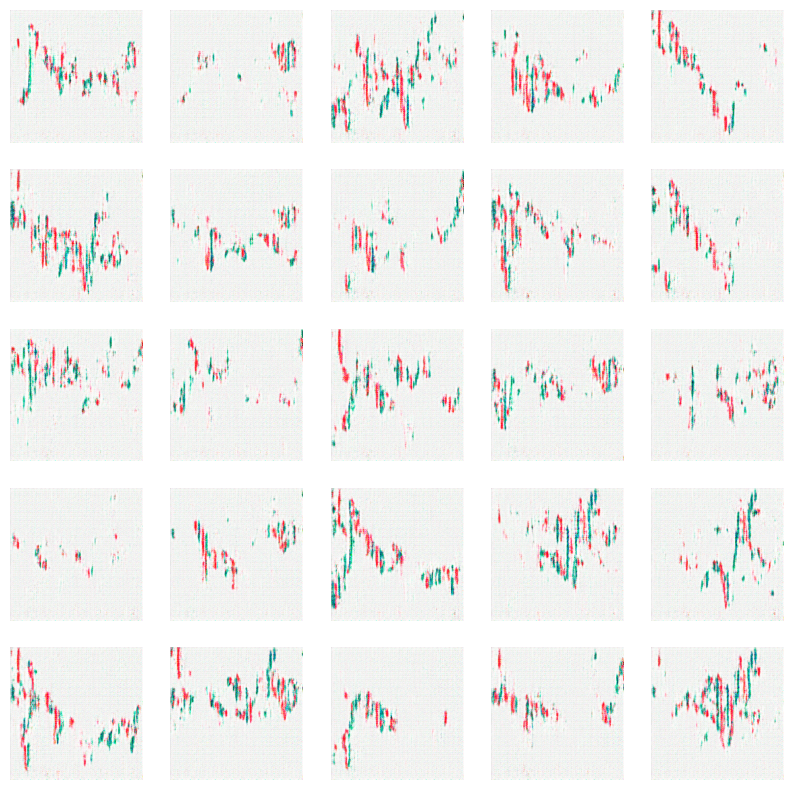


Mean Loss for every 200 epochs: 



,Epoch,Mean Loss
0,200,3.254304
1,400,3.686232
2,600,2.968532
3,800,3.602250
4,1000,4.832980
5,1200,2.997797
6,1400,4.047863


In [35]:
gan_ihs = DCGAN_model(noise_dim, EPOCHS, BATCH_SIZE, generator, discriminator, candlestick_ds_ihs)
res_ihs = gan_ihs.train_loop()
res_ihs

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

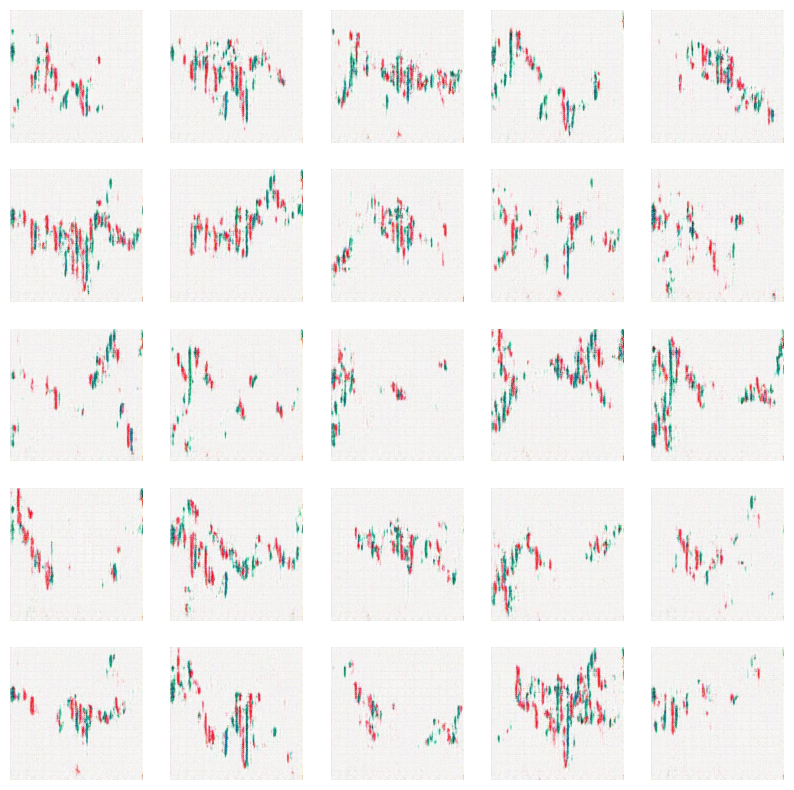

In [36]:
# checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
from PIL import Image
!mkdir ../gan_images/ihs
start = time.time()
with strategy.scope():
    for i in range(420):
        noise = tf.random.normal([BATCH_SIZE, noise_dim])
        img = generator.predict(noise)
        img = 0.5 * img + 0.5
        img = (img * 255).astype('uint8')
        img = Image.fromarray(img[0, :, :, :])
        img.save("../gan_images/ihs" + str(i) + ".jpg")
print('Total running time is {} sec'.format(time.time()-start))
fig = plt.figure(figsize=(10, 10))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.imshow(PIL.Image.open("../gan_images/ihs" + str(i) + ".jpg"))
    plt.axis('off')
plt.show()

In [37]:
# Create a zip file of the images
#!zip -q -r images.zip ../images
import shutil
shutil.make_archive("/kaggle/working/gan_images", 'zip', "/kaggle/gan_images")

'/kaggle/working/gan_images.zip'

## Create GIF